<a href="https://colab.research.google.com/github/predicthq/phq-data-science-docs/blob/master/attended-events/part_2_data_exploration.ipynb" target="_blank"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##### Attended Events Data Science Guides

# Part 2 Data Exploration
**A How To Guide to exploring PredictHQ's Attended Events (conferences, expos, concerts, festivals, performing-arts, sports, community).**

- [SDK or CSV Data Access](#csv_sdk)
- [Query Attended Events](#query_attended_events)
- [Overview of Attended Events](#event_overview)
- [Event Label Statistics](#event_labels)
- [PHQ Rank, Local Rank and Aviation Rank](#ranks)
- [Attendance Distribution](#attendance_distribution)
- [Start Time of Events](#start_time)
- [Duration](#duration)
- [First Seen Date](#first_seen_date_start_date)
- [Map Visualization](#visual_map)
- [Impact of Radius Settings](#radius_impact)
- [Event Entities](#event_entity)
- [Forecasting Impact](#forecasting_impact)



If using Google Colab, uncomment the following code block.

In [1]:
# %%capture
# !git clone https://github.com/predicthq/phq-data-science-docs.git
# %cd phq-data-science-docs/attended-events
# !pip install predicthq>=1.6.3 timezonefinder calmap==0.0.9 tonyg-rfc3339==0.1


If running locally, configure the required dependencies in your Python environment by using the [requirements.txt](https://github.com/predicthq/phq-data-science-docs/blob/master/attended-events/requirements.txt) file which is shared alongside the notebook.

These requirements can be installed by runing the command `pip install -r requirements.txt`



In [2]:
import calendar
import random
from datetime import timedelta

import calmap
import folium
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import pytz
import rfc3339
from folium.plugins import HeatMap
from plotly.subplots import make_subplots
from predicthq import Client
from timezonefinder import TimezoneFinder

# To display more columns in the dataframe.
pd.set_option("display.max_columns", 50)
%matplotlib inline


<a id='csv_sdk'></a>
# SDK or CSV Data Access
This notebook can be run using the CSV example data provided, or if you have access to the PredictHQ API, you can use the code provided to call the API using our SDK for the locations of interest to you. 

The starting point for Part 2 is the dataset created at the end of Part 1. As using the SDK is not the focus of Part 2, a function is created to call the SDK. For guidance on how to use the SDK, please refer to Part 1. If you do not have access to the SDK, the notebook also works with a number of CSV files that are provided alongside the notebook. 

In [3]:
# Set whether to run with SDK or using provided CSV files.
# Set to be either "CSV" or "SDK".
RUN_SETTING = "CSV"

if RUN_SETTING == "SDK":
    # Replace Access Token with own access token.
    ACCESS_TOKEN = "REPLACE_WITH_ACCESS_TOKEN"
    phq = Client(access_token=ACCESS_TOKEN)


def query_attended_events(
    start_time,
    end_time,
    radius,
    radius_unit,
    latitude,
    longitude,
    categories,
    rank_type=None,
    filter_parameter="gte",
    rank_threshold="40",
):
    """
    Query Attended Events based on time, location, category, and rank thresholds.
    Args:
        start_time: start of the period for querying Attended Events.
                    Format "YYYY-MM-DD"
        end_time: end of the period for querying Attended Events.
                  Format of "YYYY-MM-DD"
        radius: radius for querying Attended Events.
        radius_unit: unit of the radius.
        latitude: latitude of the interested location.
        longitude: longitude of the interested location.
        categories: list of categories, such as ["conferences", "expos", "concerts",
                    "festivals", "performing-arts", "sports", "community"].
        rank_type: when it is not None, events are filtered according to rank_type,
                   filter_parameter and rank_threshold. The value could be either
                   "rank", "local_rank" or "aviation_rank".
        filter_parameter: the value could be either "gte", "gt", "lte" or "lt".
                          Note that "lte" or "lt" is not commonly used in practice
                          since we are interested in events with large ranks.
        rank_threshold: the value could be chosen between 0 and 100 depending on the
                        assumption of interested events' sizes.
    return:
        event_df: pandas DataFrame of Attended Events.
    """
    within = f"{radius}{radius_unit}@{latitude},{longitude}"
    timezone = TimezoneFinder().timezone_at(lat=latitude, lng=longitude)

    params = {
        "active__gte": start_time,
        "active__lte": end_time,
        "active__tz": timezone,
        "within": within,
        "category": categories,
        "limit": 500,
    }

    if rank_type is not None:
        params[f"{rank_type}__{filter_parameter}"] = rank_threshold

    result_list = []

    # Iterating through all the events that match our criteria and
    # adding them to our result_list.
    for event in phq.events.search(**params).iter_all():
        result_list.append(event.model_dump())

    event_df = pd.DataFrame(result_list)

    # Selecting the target fields.
    event_df = event_df[
        [
            "id",
            "title",
            "category",
            "description",
            "duration",
            "start",
            "end",
            "predicted_end",
            "first_seen",
            "labels",
            "location",
            "place_hierarchies",
            "timezone",
            "entities",
            "phq_attendance",
            "rank",
            "local_rank",
            "aviation_rank",
        ]
    ]

    return event_df

<a id='query_attended_events'></a>
# Query Attended Events

In [4]:
start_time = "2019-01-01"
end_time = "2021-03-31"
radius = 10
radius_unit = "km"
latitude_store, longitude_store = (41.881832, -87.623177)  # Chicago example

categories = [
    "conferences",
    "expos",
    "concerts",
    "festivals",
    "performing-arts",
    "sports",
    "community",
]

file_name = (
    f"data/event_data/radius{radius}{radius_unit}_{latitude_store}_"
    + f"{longitude_store}_{start_time}_{end_time}.csv"
)

if RUN_SETTING == "SDK":
    event_df = query_attended_events(
        start_time,
        end_time,
        radius,
        radius_unit,
        latitude_store,
        longitude_store,
        categories,
    )

    event_df.to_csv(file_name, index=False)
    # Convert to string format.
    event_df["start"] = event_df["start"].apply(lambda x: str(x))
    event_df["end"] = event_df["end"].apply(lambda x: str(x))
    event_df["first_seen"] = event_df["first_seen"].apply(lambda x: str(x))
    event_df["entities"] = event_df["entities"].apply(lambda x: str(x))
elif RUN_SETTING == "CSV":
    event_df = pd.read_csv(file_name)
    # Convert string with python expression.
    event_df["labels"] = event_df["labels"].apply(lambda x: eval(x))
    event_df["location"] = event_df["location"].apply(lambda x: eval(x))
else:
    print('Must set RUN_SETTING to either "SDK" or "CSV"')

event_df = event_df.sort_values("start")

event_df = event_df[
    [
        "id",
        "title",
        "category",
        "description",
        "duration",
        "start",
        "end",
        "predicted_end",
        "first_seen",
        "labels",
        "location",
        "place_hierarchies",
        "timezone",
        "entities",
        "phq_attendance",
        "rank",
        "local_rank",
        "aviation_rank",
    ]
]

# Record the categories based on the fetched events.
categories_from_event_df = list(event_df["category"].unique())


event_df[:5].T

,38901,38900,38899,38898,38896
id,Qmhr4YY87oDYWBgg9P,dGwZXm7ACAusJMbAF6,HdhQ8ZBoTsfgs7jNf5,8hm6ncUabT6QHXm2qY,2DukUe4S6uXMTkaXum
title,Navy Pier Winter Wonderfest: The UltimateTV Co...,New Year’s Eve at RPM Steak,Ring in the New Year at Hub 51,Elf’d Up Holiday Pop-Up,New Year's Eve Dinner at Il Porcellino
category,festivals,community,community,community,community
description,The Ultimate TV and our good friends at Navy P...,Bid farewell to 2018 and ring in the New Year ...,"Kick off the New Year at Hub 51, where holiday...",The Stretch Bar and Grill for the holidays is ...,Ring in 2019 at Il Porcellino with luxe holida...
duration,720000,50400,54000,43200,75600
start,2018-12-29 16:00:00+00:00,2018-12-31 17:00:00+00:00,2018-12-31 17:00:00+00:00,2018-12-31 21:00:00+00:00,2018-12-31 22:00:00+00:00
end,2019-01-07 00:00:00+00:00,2019-01-01 07:00:00+00:00,2019-01-01 08:00:00+00:00,2019-01-01 09:00:00+00:00,2019-01-01 19:00:00+00:00
predicted_end,NaN,NaN,NaN,NaN,NaN
first_seen,2018-12-31 08:25:26+00:00,2018-11-18 09:29:39+00:00,2018-11-18 08:19:38+00:00,2018-12-14 19:14:50+00:00,2018-11-24 03:43:43+00:00
labels,"[entertainment, festival]","[community, food]","[community, food]","[community, food]","[community, food]"


### Event Preprocessing

In [5]:
def get_local_dt(dt, tz):
    """
    Localize a datetime for a given timezone.
    Args:
        dt: a datetime in string format.
        tz: timezone to localise to.
    return:
        local_dt: local datetime according to given timezone.
    """
    if not dt:
        return None

    dt = rfc3339.parse_datetime(dt)

    if not tz:
        return dt

    local_dt = dt.astimezone(pytz.timezone(tz))
    return local_dt


def update_end_time(row):
    """
    Update end time if predicted_end is available.
    """
    if isinstance(row["predicted_end"], str):
        return row["predicted_end"]
    else:
        return row["end"]


# Convert to local date and local time of the start of the event.
event_df["start_local"] = event_df.apply(
    lambda row: get_local_dt(row["start"], row["timezone"]), axis=1
)

event_df["start_date"] = event_df.start_local.map(lambda x: x.date())

# Convert to local date and local time at the end of the event.
event_df["end_update"] = event_df.apply(
    lambda row: update_end_time(row),
    axis=1,
)

event_df["end_local"] = event_df.apply(
    lambda row: get_local_dt(row["end_update"], row["timezone"]), axis=1
)

event_df["end_date"] = event_df.end_local.map(lambda x: x.date())

# Convert to local date and local time when the event was seen for the first time.
event_df["first_seen_local"] = event_df.apply(
    lambda row: get_local_dt(row["first_seen"], row["timezone"]), axis=1
)

event_df["first_seen_date"] = event_df.first_seen_local.map(lambda x: x.date())

# Duration of each event in days.
event_df["duration_day"] = event_df.apply(
    lambda row: (row["end_date"] - row["start_date"]).days + 1, axis=1
)

# Duration of each event between the first seen time and start of the event in days.
event_df["day_from_first_seen"] = event_df.apply(
    lambda row: (row["end_date"] - row["first_seen_date"]).days + 1, axis=1
)

<a id='event_overview'></a>
# Overview of Attended Events

#### Number of events per category

In [6]:
event_df_category = (
    event_df.groupby(["category"]).count()[["id"]].rename(columns={"id": "count"})
)

fig = go.Figure(
    data=[
        go.Pie(
            labels=event_df_category.index,
            values=event_df_category["count"],
        )
    ]
)

fig.update_traces(hoverinfo="label+percent", textinfo="value", textfont_size=20)
fig.show()

#### Visualize the number of events per day

In [7]:
event_split = []

# Count the number of events per day. The events with multiple-day duration
# are assigned to each of the days when they are happening.
for _, row in event_df.iterrows():
    start_date = row["start_local"].date()
    end_date = row["end_local"].date()
    delta = (end_date - start_date).days + 1

    for i in range(delta):
        event_split.append(
            {
                "date": start_date + timedelta(days=i),
                "id": row["id"],
                "title": row["title"],
                "category": row["category"],
            }
        )

event_split = pd.DataFrame(event_split)

event_split_count = (
    event_split.groupby(["date", "category"])[["id"]]
    .count()
    .rename(columns={"id": "count"})
    .reset_index()
)

event_split_count = event_split_count.pivot(
    index="date", columns="category", values="count"
).fillna(0)

event_count_per_day = pd.DataFrame(index=pd.date_range(start=start_time, end=end_time))

event_count_per_day = pd.merge(
    event_count_per_day,
    event_split_count,
    how="left",
    left_index=True,
    right_index=True,
).fillna(0)

fig = make_subplots(rows=len(categories_from_event_df), cols=1, shared_xaxes=True)

for index, category in enumerate(categories_from_event_df):
    fig.add_trace(
        go.Scatter(
            x=event_count_per_day.index,
            y=event_count_per_day[category],
            name=category,
            mode="lines+markers",
        ),
        row=index + 1,
        col=1,
    )

fig.update_layout(
    title="Number of events per day",
    title_x=0.45,
    yaxis4=dict(title="count"),
)

fig.show()

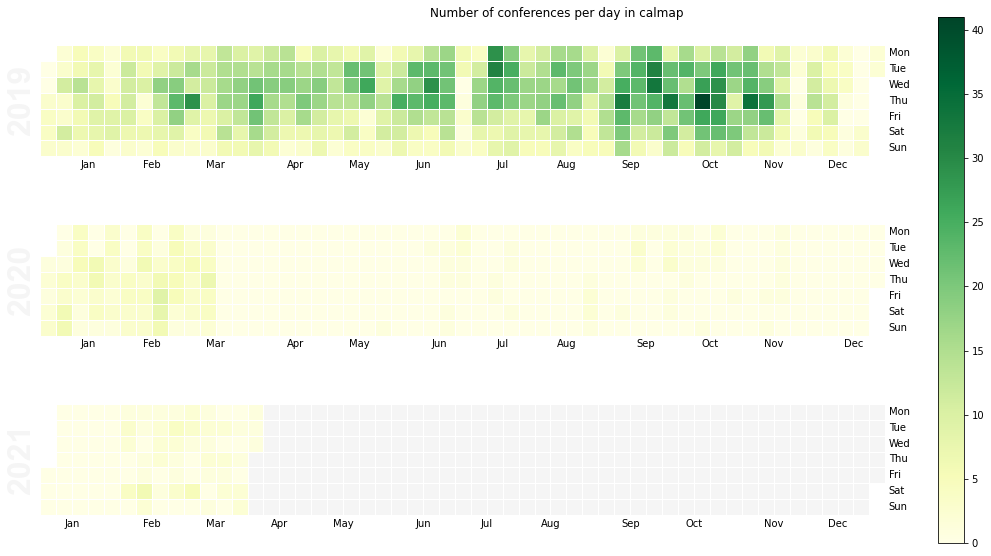

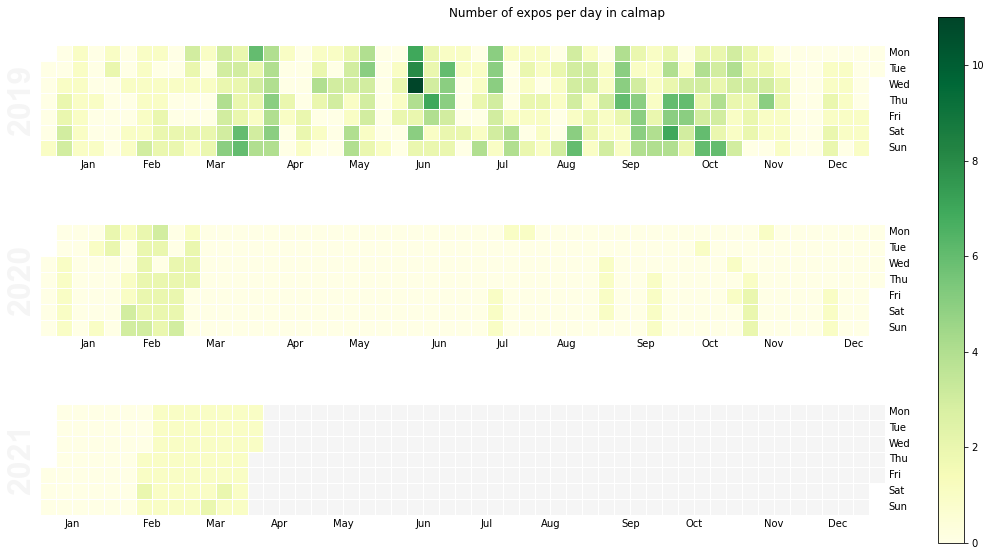

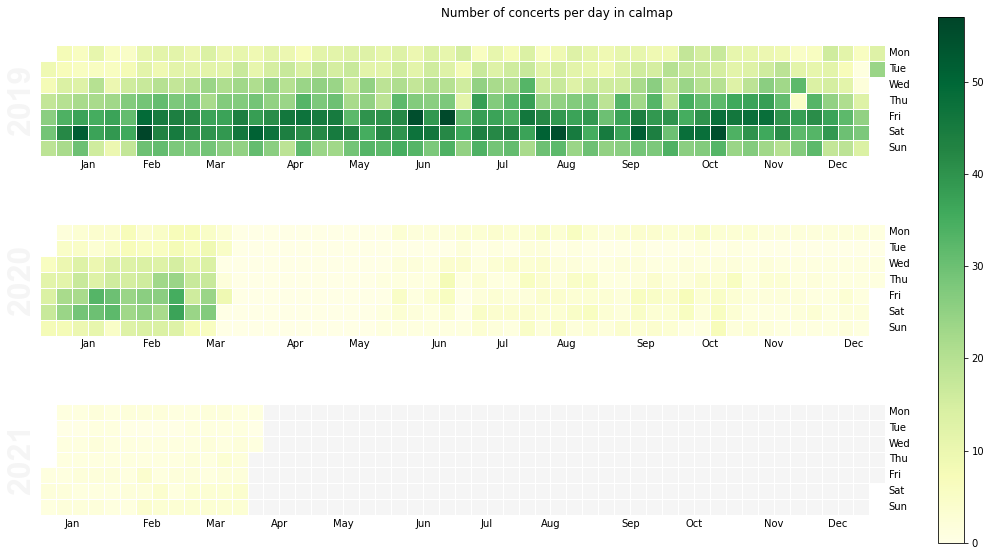

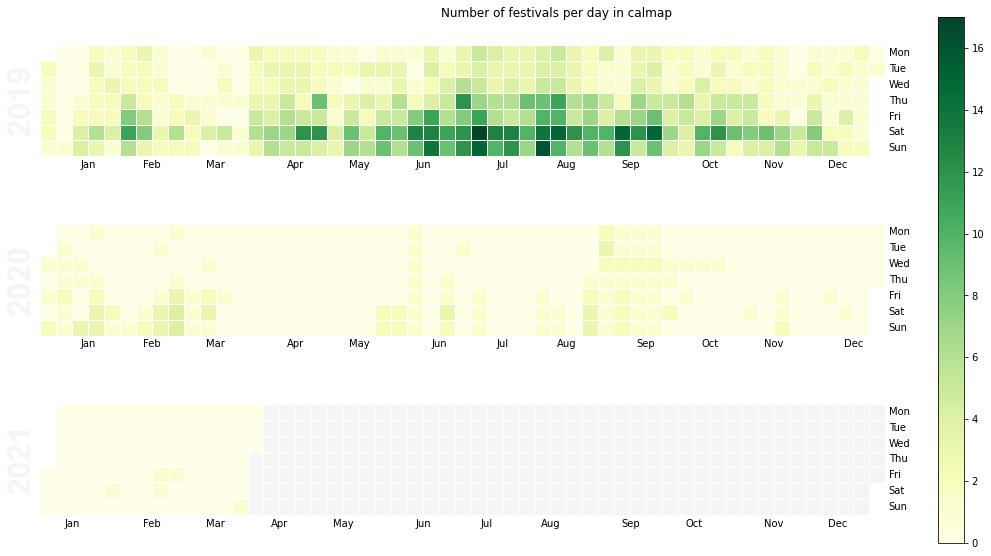

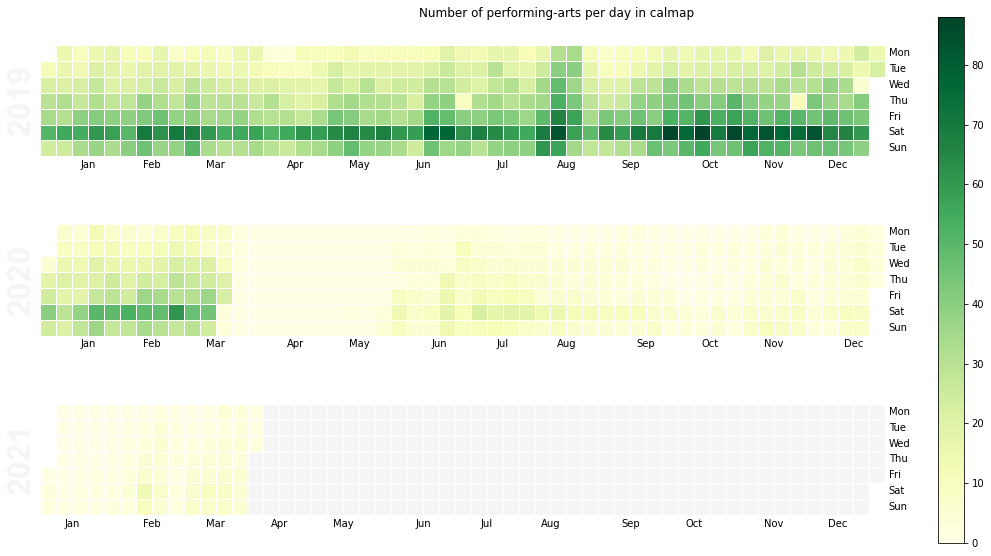

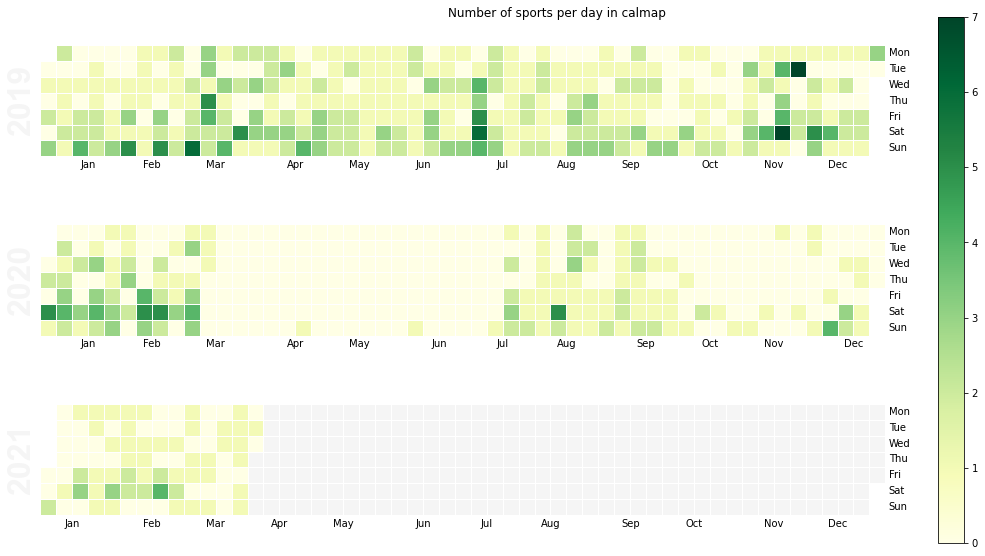

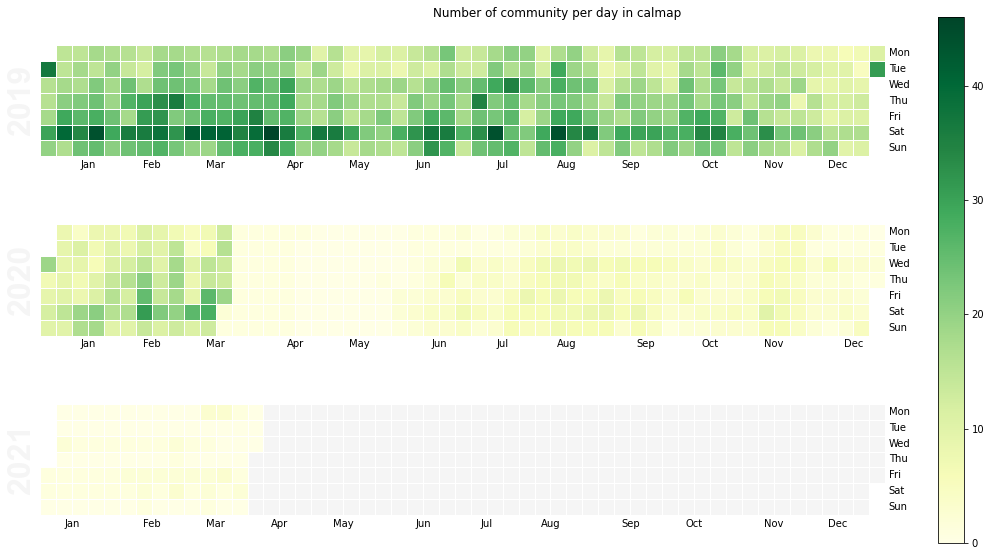

In [8]:
for category in categories_from_event_df:
    fig, ax = calmap.calendarplot(event_count_per_day[category], cmap="YlGn")
    fig.set_size_inches(18, 8)
    fig.colorbar(ax[0].get_children()[1], ax=ax.ravel().tolist())
    _ = fig.suptitle(f"Number of {category} per day in calmap")

#### Top Three days 
The three days in the dataset with the most events.

In [9]:
days_with_multiple_events = (
    event_df.groupby("start_date")
    .count()[["id"]]
    .rename(columns={"id": "count"})
    .sort_values("count", ascending=False)[:3]
    .index
)

event_df[event_df.start_date.isin(days_with_multiple_events)].groupby(
    ["start_date", "title", "category"]
).count()[
    []
]  # return empty columns since we are only interested in indexes

Empty DataFrame
Columns: []
Index: [(2019-08-17, "Manifestations" --- Chicago's Only Ghostly Dinner Event (Normally $80.00, Now Only $65.00 ), performing-arts), (2019-08-17, "South Side Summer Show", performing-arts), (2019-08-17, "The Spitfire Grill", performing-arts), (2019-08-17, --5:00pm and 7:00pm-- Vocalist Keri Johnsrud, community), (2019-08-17, -9:30pm and 11:30pm- Ryan Cohan Quartet, community), (2019-08-17, 1060 Block Party, community), (2019-08-17, 2nd Annual Choreo Kick-Off (Christina Morrison), community), (2019-08-17, A Taste of Man Flesh: A Parody About a Fellowship, performing-arts), (2019-08-17, A Woodstock 50th Anniversary Celebration with Aquarian Exposition, community), (2019-08-17, Air Credits, The Love Of Everything, and MINIVAN, concerts), (2019-08-17, Air and Water Show Viewing Party, festivals), (2019-08-17, Algorithm Nation or, The Static Quo, performing-arts), (2019-08-17, Ali Wong: The Milk & Money Tour, performing-arts), (2019-08-17, All Quiet On The Western Front, performing-arts), (2019-08-17, Art Speaks, conferences), (2019-08-17, Atish, concerts), (2019-08-17, August PEERvention Workshop: Sponsored by AFSP, conferences), (2019-08-17, Baby Soul Jam, community), (2019-08-17, Back to School Educator Appreciation Shopping Weekends, community), (2019-08-17, Bad Boys Live Male Revue, performing-arts), (2019-08-17, Bassel & the Supernaturals, concerts), (2019-08-17, Being Small (Isn't So Bad After All) & Gorillas' Night Out, community), (2019-08-17, Ben Harper with The Innocent Criminals and Trombone Shorty & Orleans Avenue, concerts), (2019-08-17, Best of Crescent Moon Nerdlesque: Celebrating 1 Year of Sexy Nerdiness, performing-arts), (2019-08-17, Bible Bingo - an Act of Charity, performing-arts), (2019-08-17, Bluegrass Brunch, community), (2019-08-17, Bobby Conn - Cheer Accident - Akosuen, concerts), (2019-08-17, Boy Band Brunch, community), (2019-08-17, Brother Ryan Record Release with Tyler Sjostrom as Ogema, concerts), (2019-08-17, Bye Bye Liver: The Chicago Drinking Play, performing-arts), (2019-08-17, Calling All Early Stage Entrepreneurs & Startup Founders in Chicago!!, conferences), (2019-08-17, Chicago Air & Water Show, festivals), (2019-08-17, Chicago Funk Mafia wsg Fuzzlove, concerts), (2019-08-17, Chicago I Declare It Tour Stop, conferences), (2019-08-17, Chicago Outdoor Adventure Pop-Up: Go-Karting & Mini Golf at Neon Summer, community), (2019-08-17, Chicago VIP Experience, community), (2019-08-17, Chicago Westside Music Festival, festivals), (2019-08-17, Chill Out at the Fairmont, community), (2019-08-17, Come From Away, performing-arts), (2019-08-17, Come From Away (Chicago), performing-arts), (2019-08-17, ComedySportz, performing-arts), (2019-08-17, Conan Neutron & The Secret Friends and Burned Or Buried, community), (2019-08-17, Concert for kids "MAGIC MOZART", community), (2019-08-17, Curious Grace & Black Rabbit, community), (2019-08-17, Dance for Life Chicago, performing-arts), (2019-08-17, Dang! Hot Bits!, performing-arts), (2019-08-17, Danny Ames, community), (2019-08-17, Daylight Disco: Quantic, concerts), (2019-08-17, Diva Royale - Drag Queen Show Chicago, performing-arts), (2019-08-17, Divine Pairings, community), (2019-08-17, Dj Corey Bless, community), (2019-08-17, Dorothy Does Oz: A Nerdlesque Parody, performing-arts), (2019-08-17, Drunk Shakespere - The Hit Theatrical Comedy, performing-arts), (2019-08-17, Eli Winter, concerts), (2019-08-17, Emma Jayne and Leah Woods, concerts), (2019-08-17, Fallen Angels Comedy Showcase 8/17, performing-arts), (2019-08-17, Fitbit Local Bodyweight Bootcamp and Yoga Flow, community), (2019-08-17, Frankenstein- theater, performing-arts), (2019-08-17, Free Workshop - Think Like a Digital Designer: Unplugged, community), (2019-08-17, GOOD VIBEZ ONLY Day Party, community), (2019-08-17, Gazebo Effect / Captain Coopersmith / Red Francis / The Off Days, concerts), (2019-08-17, GoGoGo Collabo Art Show!, performing-arts), (2019-08-17, Good Luck Fi

<a id='event_labels'></a>
# Event Label Statistics
Each event is associated with a label. Depending on your business domain, events associated with certain labels may be more or less important.

In [10]:
event_df[["title", "description", "start", "end", "labels"]].head()

,title,description,start,end,labels
38901,Navy Pier Winter Wonderfest: The UltimateTV Co...,The Ultimate TV and our good friends at Navy P...,2018-12-29 16:00:00+00:00,2019-01-07 00:00:00+00:00,"[entertainment, festival]"
38900,New Year’s Eve at RPM Steak,Bid farewell to 2018 and ring in the New Year ...,2018-12-31 17:00:00+00:00,2019-01-01 07:00:00+00:00,"[community, food]"
38899,Ring in the New Year at Hub 51,"Kick off the New Year at Hub 51, where holiday...",2018-12-31 17:00:00+00:00,2019-01-01 08:00:00+00:00,"[community, food]"
38898,Elf’d Up Holiday Pop-Up,The Stretch Bar and Grill for the holidays is ...,2018-12-31 21:00:00+00:00,2019-01-01 09:00:00+00:00,"[community, food]"
38896,New Year's Eve Dinner at Il Porcellino,Ring in 2019 at Il Porcellino with luxe holida...,2018-12-31 22:00:00+00:00,2019-01-01 19:00:00+00:00,"[community, food]"


In [11]:
label_stats = []

# For each category, calculate the occurrence of labels.
for category in categories_from_event_df:
    label_all = []

    for labels in event_df[event_df.category == category]["labels"].to_list():
        label_all.extend(labels)

    labels, counts = np.unique(label_all, return_counts=True)

    for label, count in zip(labels, counts):
        label_stats.append({"category": category, "label": label, "count": count})

label_stats = pd.DataFrame(label_stats)

fig = px.bar(label_stats, x="label", y="count", color="category")

fig.update_layout(
    yaxis_type="log",
    title="Frequency of Each Label",
    title_x=0.45,
)

fig.show()

The label information helps us understand the difference between events from each category. For example, the labels for *sports* are less relevant to labels from other categories, but *festivals* and *community* share many labels. With this level of granularity, you have a better understanding of the relationship between events from different categories and can prioritize events with particular labels. 

<a id='ranks'></a>
# PHQ Rank, Local Rank and Aviation Rank

For Attended Events, when the attendance information is available, the PHQ Rank and Local Rank are always positive. The PHQ Rank represents the attendance impact of an event. The Local Rank considers attendance impact with the event's local population density. Local Rank is useful for comparing events from multiple locations. The Aviation Rank represents the impact of people who attend the event by flight. Aviation Rank is computed by two machine learning models: one to detect whether an event will have attendees arriving by flight; the second model to predict the number of attendees which will arrive by flight.

#### Bubble plot for positive PHQ Ranks

In [12]:
event_df_rank = (
    event_df[event_df["rank"] > 0]
    .groupby(["category", "rank"])
    .count()[["title"]]
    .rename(columns={"title": "count"})
    .reset_index()
)

fig = px.scatter(
    event_df_rank,
    x="rank",
    y="category",
    size="count",
    color="category",
    hover_name="category",
    log_x=False,
    size_max=60,
)

fig.update_layout(
    title_text="Number of events per category per PHQ Rank",
    title_x=0.5,
)

fig.show()

#### Bubble plot for positive Local Ranks

In [13]:
event_df_local = (
    event_df[event_df.local_rank > 0]
    .groupby(["category", "local_rank"])
    .count()[["title"]]
    .rename(columns={"title": "count"})
    .reset_index()
)

fig = px.scatter(
    event_df_local,
    x="local_rank",
    y="category",
    size="count",
    color="category",
    hover_name="category",
    log_x=False,
    size_max=60,
)

fig.update_layout(
    title_text="Number of events per category per Local Rank",
    title_x=0.5,
)

fig.show()

#### Bubble plot for positive aviation Ranks

In [14]:
event_df_aviation = (
    event_df[event_df.aviation_rank > 0]
    .groupby(["category", "aviation_rank"])
    .count()[["title"]]
    .rename(columns={"title": "count"})
    .reset_index()
)

fig = px.scatter(
    event_df_aviation,
    x="aviation_rank",
    y="category",
    size="count",
    color="category",
    hover_name="category",
    log_x=False,
    size_max=60,
)

fig.update_layout(
    title_text="Number of events per category per Aviation Rank",
    title_x=0.5,
)

fig.show()

<a id='attendance_distribution'></a>
# Attendance Distribution

In [15]:
fig = px.histogram(
    event_df,
    x="phq_attendance",
    marginal="box",
    hover_data=["id", "title", "category"],
    color="category",
    nbins=200,
)

fig.update_layout(
    yaxis_type="log",
    title_text="Histogram of attendances per category",
    title_x=0.5,
    xaxis_title_text="attendance",
    yaxis_title_text="count",
    bargap=0.2,
    bargroupgap=0.1,
)

fig.show()

In [16]:
# Sort the events according to attendance in descending order. The events
# with null value are excluded.
attendance_sorted = (
    event_df[~event_df.phq_attendance.isnull()]
    .sort_values("phq_attendance", ascending=False)
    .phq_attendance.values
)

# The cumsum accumulates the attendance of the events in the list.
cumsum = np.cumsum(attendance_sorted)

fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x=np.array([i for i in range(len(cumsum))]) / len(cumsum),
        y=cumsum / cumsum.max(),
        marker=dict(color="rgb(150, 25, 120)"),
    )
)

fig.update_yaxes(tickformat="%")
fig.update_xaxes(tickformat="%")

fig.update_layout(
    title_text="Cumulative distribution percentage of largest events and percentage of total attendance",
    title_x=0.5,
    xaxis_title_text="percentage of largest events",
    yaxis_title_text="percentage of total attendance",
)

fig.show()

We see from the above plots that `phq_attendance` has a skewed distribution. For machine learning tasks, including demand forecasting, designing appropriate features for data with skewed distributions will be needed. The cumulative distribution provides insights for customers to prioritize different events.

#### Events by category

In [17]:
event_df_cateogry = (
    event_df.groupby("category")
    .agg(attendance=("phq_attendance", "sum"), event_count=("id", "count"))
    .reset_index()
)

fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Scatter(
        x=event_df_cateogry["category"],
        y=event_df_cateogry["attendance"],
        name="phq_attendance",
    ),
    secondary_y=True,
)

fig.add_trace(
    go.Bar(
        x=event_df_cateogry["category"],
        y=event_df_cateogry["event_count"],
        name="event_count",
    )
)

fig.update_layout(
    title_text=f"Attendance and count by category - <br>Date range {start_time} to {end_time}"
)

fig.update_yaxes(title_text="event count", secondary_y=False)
fig.update_yaxes(title_text="phq_attendance", secondary_y=True)
fig.show()

The `phq_attendance` and event counts have different distributions. For example, *sports* and *festivals* have the largest attendance numbers although their event counts are much smaller than the event counts for *community* and *performing-arts*.

<a id='start_time'></a>
# Start Time of Events

To facilitate data exploration, a rank threshold is introduced to explore events when PHQ Rank is greater than the threshold.

### Stats of start time in time of day

In [18]:
rank_threshold_for_start_time = 30
second_constant = 60 * 60  # The number of seconds in an hour


def get_time_of_date(dt):
    """
    Estimate the time of day which is in the range between 0 and 24.
    """
    hour = dt.hour
    minute = dt.minute
    second = dt.second
    return (hour * 3600 + minute * 60 + second) / second_constant


event_df["time_of_day_start"] = event_df.apply(
    lambda row: get_time_of_date(row["start_local"]), axis=1
)

fig = px.histogram(
    event_df[event_df["rank"] > rank_threshold_for_start_time],
    x="time_of_day_start",
    marginal="box",
    hover_data=["id", "title", "category", "labels"],
    nbins=24,
    color="category",
    range_x=[0, 24],
)

fig.update_layout(
    title_text=f"Histogram of the start time in time of day (PHQ Rank>{rank_threshold_for_start_time})",
    title_x=0.5,
    xaxis_title_text="time of day",
    yaxis_title_text="Count",
    bargap=0.2,
    bargroupgap=0.1,
)

fig.show()

#### Events start in the early morning between 1am and 5am

In [19]:
event_df[
    (event_df["time_of_day_start"] > 1)
    & (event_df["time_of_day_start"] < 5)
    & (event_df["rank"] > rank_threshold_for_start_time)
][["id", "title", "category", "start_local", "end_local"]].head()

,id,title,category,start_local,end_local
30354,aoWg8uP9WiKiskU7jH,Post Game w/ Hello Weekend,community,2019-04-13 04:30:00-05:00,2019-04-13 04:30:00-05:00
18409,rXZqMvJD8eZgJcMXSm,Chicago Triathlon,sports,2019-08-25 04:00:00-05:00,2019-08-25 14:00:00-05:00
8567,AB6DMVorwipcPfFQFn,House of Blues Concerts,community,2019-12-12 03:11:47-06:00,2019-12-12 06:11:47-06:00
7885,WoTuzKC6XAJor4GzLc,Zeds Dead and LICK,concerts,2019-12-21 01:30:00-06:00,2019-12-21 01:30:00-06:00
7774,G4UShFB4BYcx2WTPpM,Zeds Dead,concerts,2019-12-22 01:30:00-06:00,2019-12-22 01:30:00-06:00


### Stats of start time in day of week

In [20]:
event_df["weekday_number"] = event_df.apply(
    lambda row: row["start_local"].weekday(), axis=1
)

event_df["weekday_name"] = event_df["weekday_number"].apply(
    lambda x: calendar.day_name[x]
)

fig = px.histogram(
    event_df[event_df["rank"] > rank_threshold_for_start_time],
    x="weekday_name",
    nbins=7,
    color="category",
    category_orders={  # replaces default order by column name
        "weekday_name": [abbr for i, abbr in enumerate(calendar.day_name)]
    },
)

fig.update_layout(
    title_text=f"Histogram of the start time in day of week (PHQ Rank>{rank_threshold_for_start_time})",
    title_x=0.5,
    xaxis_title_text="Day of week",
    yaxis_title_text="Count",
    bargap=0.2,
    bargroupgap=0.1,
)

fig.show()

### Stats of start time in months

In [21]:
event_df["month_number"] = event_df.apply(lambda row: row["start_local"].month, axis=1)
event_df["month_name"] = event_df["month_number"].apply(
    lambda x: calendar.month_abbr[x]
)

fig = px.histogram(
    event_df[event_df["rank"] > rank_threshold_for_start_time],
    x="month_name",
    nbins=12,
    color="category",
    category_orders={  # replaces default order by column name
        "month_name": [abbr for i, abbr in enumerate(calendar.month_abbr[1:])]
    },
)

fig.update_layout(
    title_text=f"Histogram of the start time in months (PHQ Rank>{rank_threshold_for_start_time})",
    title_x=0.5,
    xaxis_title_text="Month",
    yaxis_title_text="Count",
    bargap=0.2,
    bargroupgap=0.1,
)

fig.show()

The start time has different patterns from events from different categories. For example, in the time of day plot, most of the events from *expos* start during daytime while most of the events from *concerts* start in the evening.

For the patterns in time of year, the increase of events in the first three months is mainly due to the impact of Covid-19. We recommend to have events from multiple years to generate the patterns in time of year plot. Otherwise, the pattern based on a short duration would not be reliable. For patterns from time of day and time of year, it is of less concern as long as the duration spans more than 6 months.

<a id='duration'></a>
# Duration
Most of the events have one day duration. *Festivals* and *performing-arts* might have duration more than two months.

In [22]:
rank_threshold_for_duration = 30

fig = px.histogram(
    event_df[event_df["rank"] > rank_threshold_for_duration],
    x="duration_day",
    marginal="box",
    hover_data=["id", "title", "category"],
    color="category",
    nbins=100,
)

fig.update_layout(
    yaxis_type="log",
    title_text=f"Duration of Events (PHQ Rank>{rank_threshold_for_duration})",
    title_x=0.5,
    xaxis_title_text="duration (day)",
    yaxis_title_text="count",
    bargap=0.2,
    bargroupgap=0.1,
)

fig.show()

For events with start and end time on the same day, here are the stats of duration in hours. Events with the same start time as their end time are excluded since this means the end time is missing.

In [23]:
event_df["duration_hour"] = event_df[["start_local", "end_local"]].apply(
    lambda row: (row["end_local"] - row["start_local"]).total_seconds() / 3600,
    axis=1,
)

fig = px.histogram(
    event_df[
        (event_df["rank"] > rank_threshold_for_duration)
        & (event_df.duration_hour <= 24)
        & (event_df.duration_hour > 0)
    ],
    x="duration_hour",
    marginal="box",
    hover_data=["id", "title", "category"],
    color="category",
    nbins=50,
)

fig.update_layout(
    title_text=f"Duration of Events with start and end time in the same day (PHQ Rank>{rank_threshold_for_duration})",
    title_x=0.5,
    xaxis_title_text="duration (hour)",
    yaxis_title_text="count",
    bargap=0.2,
    bargroupgap=0.1,
    xaxis_range=[-0.8, 24.5],
)

fig.show()

#### Events with Multiple Day Duration

In [24]:
event_df[
    (event_df["duration_day"] > 40) & (event_df["rank"] > rank_threshold_for_duration)
][["title", "start", "end", "category", "duration_day"]].head()

,title,start,end,category,duration_day
37914,"Free Comedy Show, Raffle Prizes and Drinks",2019-01-16 01:30:00+00:00,2019-03-27 02:30:00+00:00,performing-arts,71
25288,Grant Park Music Festival,2019-06-12 23:30:00+00:00,2019-08-17 02:30:00+00:00,festivals,66
23887,Chicago SummerDance,2019-06-27 05:00:00+00:00,2019-08-25 04:59:59+00:00,festivals,59


For events with multiple-day duration, they might have different impacts on different days. The `phq_attendance` might need to be split into daily levels, especially for events with long duration.

<a id='first_seen_date_start_date'></a>
# First Seen Date

The `first_seen_date` field contains the time when we received an event. Based on the `first_seen_date` and the start time of events, we can estimate how many days we know about the event before it starts. The stats of this duration is useful for forecasting tasks.

In [25]:
rank_threshold_for_first_seen = 30
event_df_for_first_seen = event_df[event_df["rank"] > rank_threshold_for_first_seen]

fig = px.histogram(
    event_df_for_first_seen,
    x="day_from_first_seen",
    marginal="box",
    hover_data=["id", "title", "category"],
    nbins=50,
    color="category",
)

fig.update_layout(
    # yaxis_type="log",
    title_text=f"Number of days between first time seen and start_time (PHQ Rank>{rank_threshold_for_first_seen})",
    title_x=0.5,
    xaxis_title_text="Days",
    yaxis_title_text="Count",
    bargap=0.2,
    bargroupgap=0.1,
)

fig.show()

#### Stats of events where the first seen times are at least 1 day, 1 week, 2 weeks before the start times. 

In [26]:
percent_one_day_before = (
    100
    * len(event_df_for_first_seen[event_df_for_first_seen.day_from_first_seen >= 1])
    / len(event_df_for_first_seen)
)

percent_one_week_before = (
    100
    * len(event_df_for_first_seen[event_df_for_first_seen.day_from_first_seen >= 7])
    / len(event_df_for_first_seen)
)

percent_two_week_before = (
    100
    * len(event_df_for_first_seen[event_df_for_first_seen.day_from_first_seen >= 14])
    / len(event_df_for_first_seen)
)

print(
    "{0:0.2f}% of events which start at least 1 day after their first see time.".format(
        percent_one_day_before
    )
)

print(
    "{0:0.2f}% of events which start at least 1 week after their first see time.".format(
        percent_one_week_before
    )
)

print(
    "{0:0.2f}% of events which start at least 2 weeks after their first see time.".format(
        percent_two_week_before
    )
)

97.98% of events which start at least 1 day after their first see time.
93.76% of events which start at least 1 week after their first see time.
88.02% of events which start at least 2 weeks after their first see time.


#### Events first seen after they happened

In [27]:
event_df_for_first_seen[event_df_for_first_seen.day_from_first_seen < -300][
    [
        "id",
        "title",
        "start",
        "end",
        "category",
        "first_seen",
        "day_from_first_seen",
    ]
]

,id,title,start,end,category,first_seen,day_from_first_seen
37731,NqjWYzDxP4Bh3yiHsh,St. John´s Red Storm vs DePaul Blue Demons,2019-01-19 01:00:00+00:00,2019-01-19 01:00:00+00:00,sports,2020-02-28 02:18:52+00:00,-404
37482,B8FEmYaUuHsMSG4fU7,Seton Hall Pirates vs DePaul Blue Demons,2019-01-20 20:00:00+00:00,2019-01-20 20:00:00+00:00,sports,2020-02-29 05:26:29+00:00,-403
36406,7ebxazzCGukuozWVNL,Marquette Golden Eagles vs DePaul Blue Demons,2019-02-03 19:00:00+00:00,2019-02-03 19:00:00+00:00,sports,2020-02-28 01:34:55+00:00,-388
36103,PWumZuVrPnCf5PhseY,Villanova Wildcats vs DePaul Blue Demons,2019-02-09 01:00:00+00:00,2019-02-09 01:00:00+00:00,sports,2020-02-29 05:54:52+00:00,-384
35876,NCyjwwqTE7fmsqhwZ7,Georgetown Hoyas vs DePaul Blue Demons,2019-02-10 20:00:00+00:00,2019-02-10 20:00:00+00:00,sports,2020-02-28 01:23:31+00:00,-381
32988,7PuPF6RK2wg6mBsHir,Illinois Fighting Illini vs Iowa Hawkeyes,2019-03-15 01:57:00+00:00,2019-03-15 01:57:00+00:00,sports,2020-02-29 08:26:40+00:00,-351
31575,mkvjvJtdgxiGGdzuYK,Missouri State Bears vs Stanford Cardinal,2019-03-30 22:30:00+00:00,2019-03-30 22:30:00+00:00,sports,2020-02-29 06:17:02+00:00,-335


Note that the above events started before 2020. We improved event coverage in 2020. This means events which happen in 2020 and later are more timely reported.

<a id='visual_map'></a>
# Map Visualization

#### Visualization of locations on a map

Visualize top 100 events in terms of attendance from each category.

In [28]:
map_markers = folium.Map(location=[latitude_store, longitude_store], zoom_start=11)
i = 0

colors = [
    "red",
    "blue",
    "green",
    "purple",
    "orange",
    "darkred",
    "lightred",
]

event_df_categories = []

for category in categories_from_event_df:
    event_df_category = event_df[event_df["category"] == category].sort_values(
        "phq_attendance", ascending=False
    )[:100]

    event_df_categories.append(event_df_category)
    feature_group = folium.FeatureGroup(name=category)

    for index, row in event_df_category.iterrows():
        longitude, latitude = row["location"]
        feature_group.add_child(
            folium.Marker(
                [latitude, longitude],
                tooltip=folium.Tooltip(row["title"]),
                icon=folium.Icon(color=colors[i]),
            )
        )

    map_markers.add_child(feature_group)
    i = i + 1

map_markers.add_child(folium.map.LayerControl())

event_df_categories = pd.concat(event_df_categories)[
    ["title", "location", "phq_attendance"]
]

map_markers

#### Heatmap for the attendance of top 100 events

In [29]:
map_heat = folium.Map(location=[latitude_store, longitude_store], zoom_start=12)

heat_data = []

# For each event, extract the location and attendance information.
for index, row in event_df_categories.iterrows():
    longitude, latitude = row["location"]
    phq_attendance = row["phq_attendance"]
    if phq_attendance > 0:
        heat_data.append([latitude, longitude, phq_attendance])


HeatMap(heat_data, radius=30).add_to(map_heat)
map_heat

<a id='radius_impact'></a>
# Impact of Radius Settings

Here we summarize Events information for a range of radii: 1km, 2km, 4km, 8km, 16km and 32km. A rank threshold is used to query large events only.

In [30]:
res_stat = []  # Results of stats for different radii.
res_df = []  # Results of DataFrame for different radii.
radius_unit = "km"
rank_type = "rank"
filter_parameter = "gte"
rank_threshold = 50

# Extract stats for events with radii from 1km, 2km, 4km, 8km, 16km and 32km.
for radius_impact in [1, 2, 4, 8, 16, 32]:
    file_name = (
        f"data/event_data/radius{radius_impact}{radius_unit}_{latitude_store}_{longitude_store}"
        + f"_{start_time}_{end_time}_{rank_type}_{filter_parameter}_{rank_threshold}.csv"
    )

    if RUN_SETTING == "SDK":
        event_df_radius = query_attended_events(
            start_time,
            end_time,
            radius_impact,
            radius_unit,
            latitude_store,
            longitude_store,
            categories,
            rank_type,
            filter_parameter,
            rank_threshold,
        )

        event_df_radius.to_csv(
            file_name,
            index=False,
        )
    else:
        event_df_radius = pd.read_csv(file_name)
        # Convert string with python expression.
        event_df_radius["location"] = event_df_radius["location"].apply(
            lambda x: eval(x)
        )

    stat = event_df_radius.groupby(["category"])["title"].count().to_dict()
    stat["radius"] = radius_impact
    res_stat.append(stat)

    event_df_radius["radius"] = f"{radius_impact}{radius_unit}"
    res_df.append(event_df_radius)

res_stat = pd.DataFrame(res_stat)

fig = go.Figure()

# The event_df_radius contains the events from the largest radius setting. 
for category in event_df_radius["category"].unique():
    fig.add_trace(go.Scatter(x=res_stat.index, y=res_stat[category], name=category))

fig.update_layout(
    xaxis_type="log",
    yaxis_type="log",
    title=f"Number of events with PHQ Rank >= {rank_threshold}",
    title_x=0.45,
    xaxis=dict(
        title="radius (km)",
    ),
    yaxis=dict(
        title="count",
    ),
)

fig.show()

In [31]:
map_radius = folium.Map(location=[latitude, longitude], zoom_start=10)
folium.Marker(location=[latitude, longitude]).add_to(map_radius)

# Draw circle for different radii.
for radius_impact in [1, 2, 4, 8, 16, 32]:
    folium.Circle(
        [latitude, longitude],
        radius=radius_impact * 1000,
        tooltip=f"{radius_impact}{radius_unit}",
    ).add_to(map_radius)

# Add top 100 events to enrich the location of the events.
event_df_radius = res_df[-1]
i = 0

event_df_categories = []

for category in event_df_radius["category"].unique():
    event_df_category = event_df_radius[event_df_radius["category"] == category].sort_values(
        "phq_attendance", ascending=False
    )[:100]

    event_df_categories.append(event_df_category)
    feature_group = folium.FeatureGroup(name=category)

    for index, row in event_df_category.iterrows():
        longitude, latitude = row["location"]
        feature_group.add_child(
            folium.Marker(
                [latitude, longitude],
                tooltip=folium.Tooltip(row["title"]),
                icon=folium.Icon(color=colors[i]),
            )
        )

    map_radius.add_child(feature_group)
    i = i + 1

map_radius.add_child(folium.map.LayerControl())

map_radius

The number of events increases as the radius becomes larger. Visualizing radii is helpful when deciding the optimal radius for events which have impact for your business.

<a id='event_entity'></a>
# Popular venues and event-groups

Events might be associated with entities such as venues and event-groups. The entities could be used to enrich events.

In [32]:
rank_threshold_for_entity = 30
event_df["entities"] = event_df["entities"].apply(lambda x: str(x))
entities = []

for entity in event_df[event_df["rank"] > rank_threshold_for_entity].entities.values[:]:
    # Entity is a string with dictionary format and we convert it to a dictionary.
    entities.extend(eval(entity))

entities = pd.DataFrame(entities)
entities.head()

,entity_id,name,type,formatted_address
0,jcJDkqQBbnT8CxTX8CZvPr,Deuces and The Diamond Club,venue,"3505 North Clark Street\nChicago, IL 60657\nUn..."
1,8GJBunkEhFhTX392LQb374,Renaldi's After Dark,venue,"2831 N Broadway\nLakeview\nChicago, IL 60657"
2,9779VUrDfzsaUhJT2tmsyu,The Mid,venue,"306 North Halsted Street\nChicago, IL 60661\nU..."
3,km7eVwN9sufWPMqzaLfECk,Studio Paris Nightclub,venue,59 W Hubbard St\nIL 60654\nUnited States of Am...
4,AMzgDincMHDapJYQK89CuR,PRYSM Nightclub,venue,"1543 North Kingsbury Street\nChicago, IL 60642..."


In [33]:
def random_color_generator(number_of_colors):
    color = [
        "#" + "".join([random.choice("0123456789ABCDEF") for j in range(6)])
        for i in range(number_of_colors)
    ]
    return color


number_of_entities = 20

# Visualize the popular entities per type.
for type_name in entities.type.unique():
    entities_type = (
        entities[entities.type == type_name]
        .groupby("name")
        .count()[["entity_id"]]
        .rename(columns={"entity_id": "count"})
        .sort_values("count", ascending=False)["count"][:number_of_entities]
    )

    fig = go.Figure()

    fig.add_trace(
        go.Bar(
            y=entities_type.index[::-1],
            x=entities_type.values[::-1],
            textposition="auto",
            textfont=dict(size=12, color="rgb(0, 0, 0)"),
            orientation="h",
            marker=dict(
                color=random_color_generator(number_of_entities),
                line=dict(
                    color="rgb(8,48,107)",
                    width=1.5,
                ),
            ),
            opacity=0.7,
        )
    )

    fig.update_layout(
        title_text=f"Popular {number_of_entities} {type_name} for event with PHQ Rank > {rank_threshold_for_entity}",
        title_x=0.5,
        titlefont=dict(size=15),
        xaxis=dict(
            title="Count",
            tickfont=dict(
                size=12,
            ),
        ),
        yaxis=dict(
            tickfont=dict(
                size=12,
            )
        ),
    )

    fig.show()

The popular venue entities help you to understand the locations of the events. You might have additional information from these venues to enrich the event impact patterns. The events from the same event-groups usually bring similar impact. This would lead to robust estimation for demand impacts.

<a id='forecasting_impact'></a>
# Forecasting Impact

Within this notebook, we've gained a better understanding of PredictHQ's Attended Events (conferences, expos, concerts, festivals, performing-arts, sports, community).

By using this information we can make better decisions about how to incorporate these data points into forecasting.

Here's a summary of some of the key take-ways from each section. 

- **[Overview of Attended Events](#event_overview)**<br>
    Form the overview of events, we could see the distribution of events from different categories and different days. Due to the impact of Covid-19, there are fewer events in 2020 and 2021 than in 2019, but we see the recovery of Attended Events in recent months.
- **[Event Label Statistics](#event_labels)**<br>
    Event labels help to provide more detailed information to understand the relationship between events from different categories and make it easier to filter for events relevant to your business.
- **[PHQ Rank, Local Rank and Aviation Rank](#ranks)**<br>
    Events can be filtered by a threshold according to different ranks. The stats and bubble plot shed light on how to determine the rank threshold.
- **[Attendance Distribution](#attendance_distribution)**<br>
    Distribution of attendance numbers would be helpful for feature engineering and prioritizing different events. For machine learning tasks, including demand forecasting, designing appropriate features from data with skewed distributions would be useful. The cumulative distribution would be useful for customers to decide the priority of events to target. 
- **[Start Time of Events](#start_time)**<br>
    From the stats of start time of events, we could identify different patterns for different events from different categories. 
- **[Duration](#duration)**<br>
    Most of the events have one day duration. *Festivals* and *performing-arts* might have durations of more than two months. For events with multiple-day duration, the impact in each day could be different.
- **[First Seen Date](#first_seen_date_start_date)**<br>
    Most of the Attended Events are known one or two weeks before they start. This is important to utilize Attended Events in forecasting tasks. 
- **[Map Visualization](#visual_map)**<br>
    The location and heat maps are useful to identify the location of events. This could be used as a tool to decide the region of interest when filtering events.
- **[Impact of Radius Settings](#radius_impact)**<br>
    The stats of events from different radii would indicate the most suitable radius when querying events.
- **[Event Entities](#event_entity)**<br>
    Events can be linked with entity information. This helps to understand popular venues and event-groups and their potential impact on your business.